# Time Series Analysis using SAS code

In [1]:
import sys
try:
    import saspy
except:
    !pip install saspy

In [2]:
# check the version of SASPy
saspy.__version__

'5.4.4'

In [3]:
# Start a SAS session, SAS is running in UTF-8

sas_sess = saspy.SASsession()

Using SAS Config named: oda
SAS Connection established. Subprocess id is 18648



    Data Information from https://finance.yahoo.com/quote/HSD.TO/history?p=HSD.TO
        Features
            Date — Trading Date
            Open — The opening price for the that date.
            Close — The closing price for the that date.
            High — The highest price for the that date.
            Low — The lowest price for the that date.
            Volume — Total amount of trading activity
            Adj.Close — Adjusted values factor in corporate actions such as dividends, stock splits, and new share issuance.
        Dimension
            Rows : 6022 ; Column : 7

        Period
            Jan 3, 2000 to Dec 7, 2023

from https://topforeignstocks.com/2023/02/03/growth-of-sp-500-thru-crisis-and-events-from-1970-to-2022-chart/

![image.png](https://topforeignstocks.com/wp-content/uploads/2023/02/SP-500-Total-Return-from-1970-to-2022.jpg)

from https://seekingalpha.com/article/4557116-s-and-p-500-why-the-odds-always-favour-the-bulls

![image.png](https://static.seekingalpha.com/uploads/2022/11/12/25338263-166826253400855_origin.png)


from https://ritholtz.com/2022/06/10-friday-am-reads-369/

![image.png](https://ritholtz.com/wp-content/uploads/2022/06/bearhistory.png)


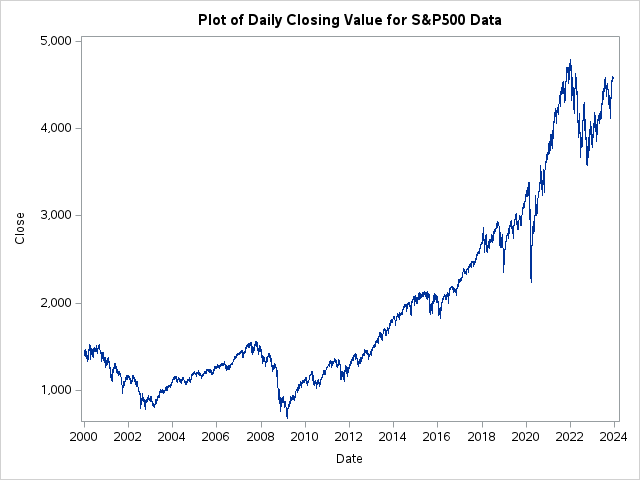

In [4]:
%%SAS sas_sess

FILENAME REFFILE '/home/u61624884/SP500.csv';
   
PROC IMPORT DATAFILE=REFFILE
    DBMS=CSV
    OUT=WORK.IMPORT;
    GETNAMES=YES;
RUN;

PROC CONTENTS DATA=WORK.IMPORT; RUN;

proc sort data=WORK.IMPORT out=preProcessedData;
    by date;
run;

DATA SP500data;
    ln_Volume =log(Volume);
    set preProcessedData;
    format Date date10. Open comma8.2 High comma8.2 Low comma8.2 Close comma8.2 
        AdjClose comma8.2 Volume comma20.2 ln_Volume comma8.2;
RUN;

/* print first 5 observations */
proc print data=SP500data (obs=5);
run;

/* Checking the contents of the datasets */
proc means data=SP500data N Nmiss mean median STD max min;
run;

title "Plot of Daily Closing Value for S&P500 Data";
proc sgplot data=SP500data;
   series x=date y=Close ;
run;
title;

### Step 1 : Check the time series

### Time-series components 
    https://www.timescale.com/blog/what-is-time-series-analysis-with-examples-and-applications/
    
    * To correctly analyze time-series data, we need to look to the four components of a time series:

    * Trend: this is a long-term movement of the time series, such as the decreasing average heart rate of workouts as a person gets fitter.
    
    * Seasonality: regular periodic occurrences within a time interval smaller than a year (e.g., higher step count in spring and autumn because it’s not too cold or too hot for long walks).
    
    * Cyclicity: repeated fluctuations around the trend that are longer in duration than irregularities but shorter than what would constitute a trend. In our walking example, this would be a one-week sightseeing holiday every four to five months.
    
    * Irregularity: short-term irregular fluctuations or noise, such as a gap in the sampling of the pedometer or an active team-building day during the workweek.

#### Average accumulated time series by month


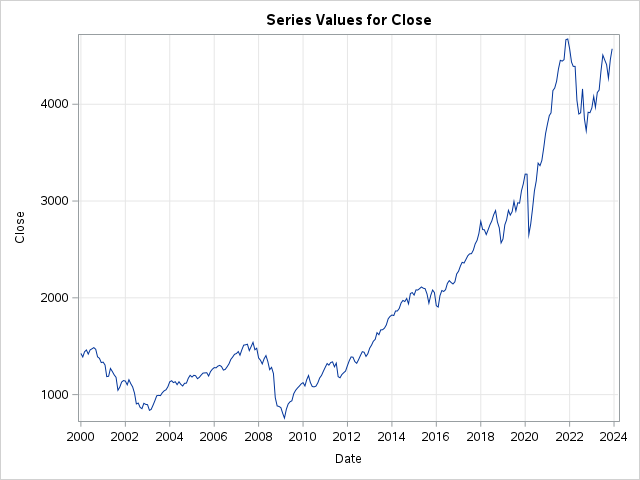
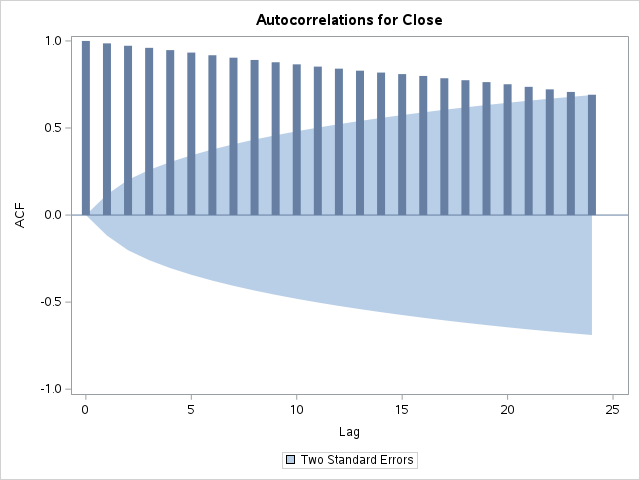
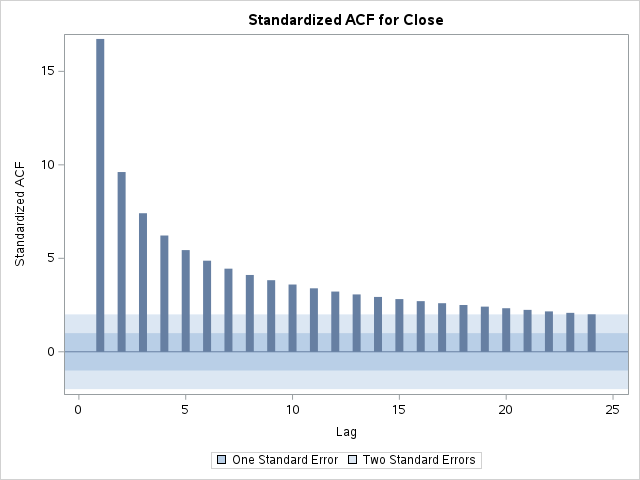
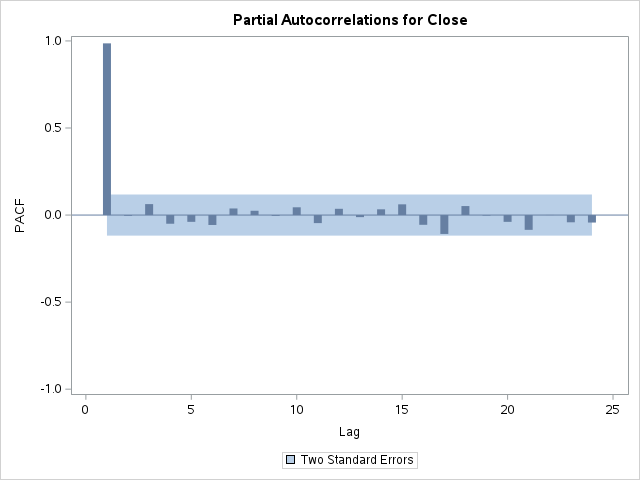
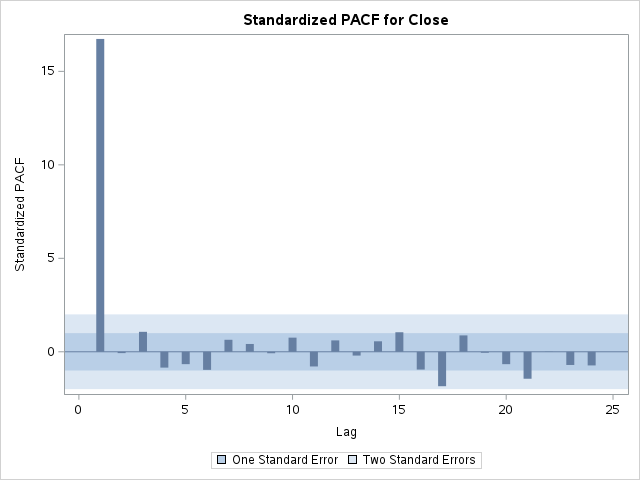

In [5]:
%%SAS sas_sess

/* accumulate to a monthly interval using AVERAGE */
proc timeseries data=SP500data out=out_totalmonth plots=(series ACF PACF);
    id date interval=month accumulate=average;
    var close;
    title "Accumulate by month - Average";
run;
title;

#### Average accumulated time series by quater


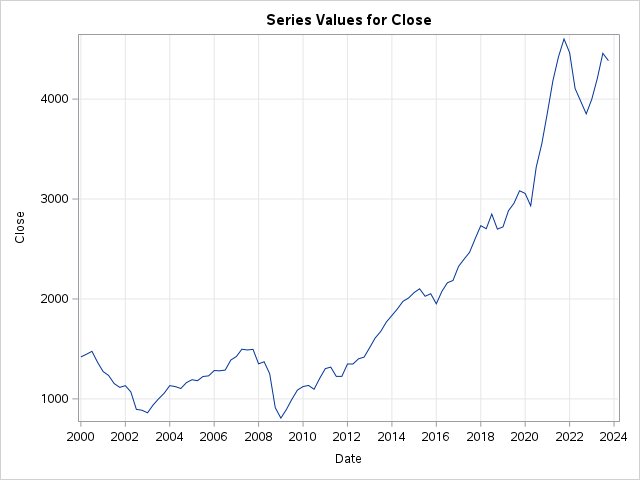
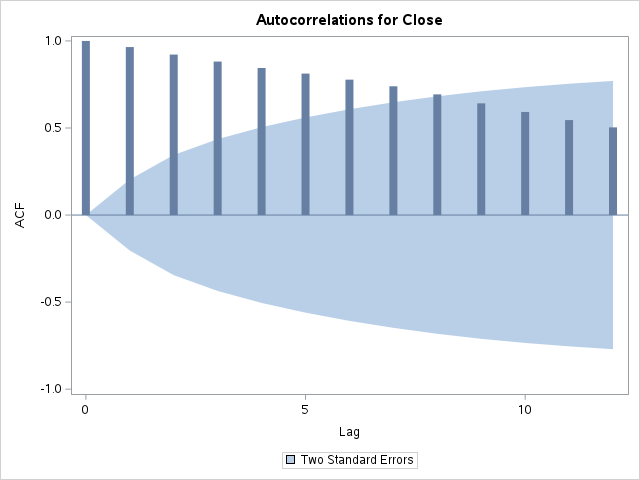
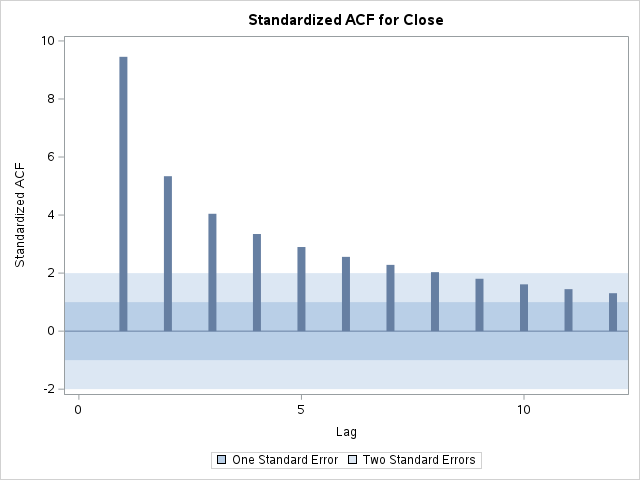
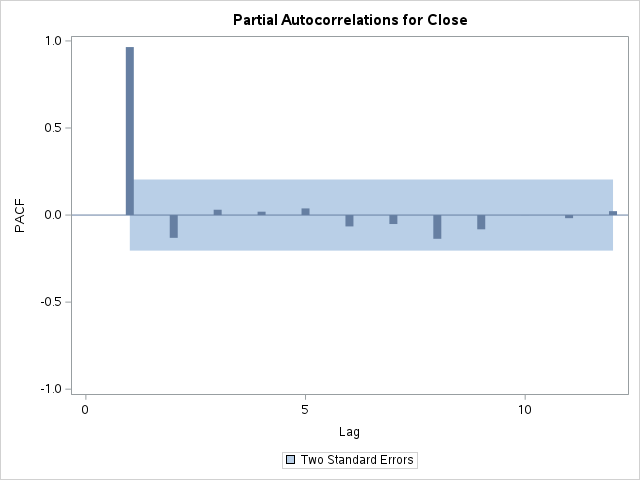
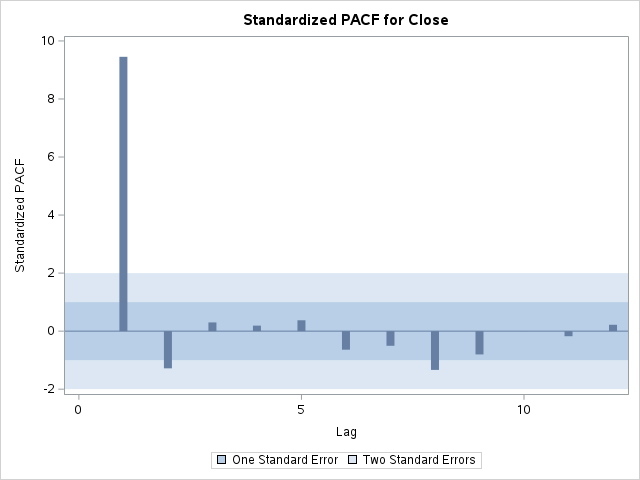

In [6]:
%%SAS sas_sess

/* accumulate to a quarterly interval using AVERAGE */
proc timeseries data=SP500data out=out_totalqtr plots=(series  ACF PACF);
    id date interval=qtr accumulate=average;
    var close;
    title "Accumulate by quarter - Average";
run;
title;

#### Average accumulated time series by year


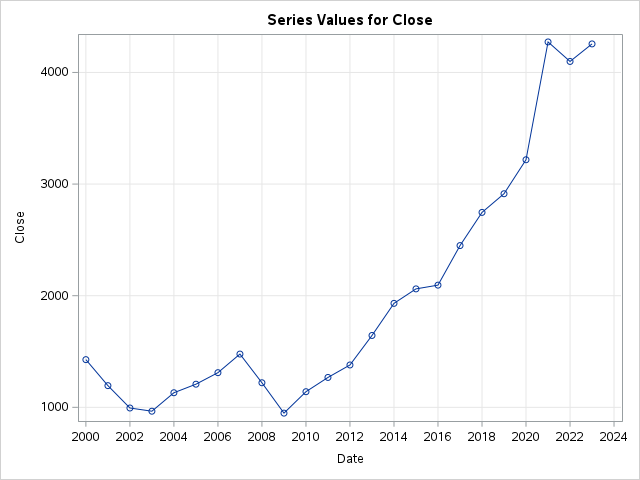
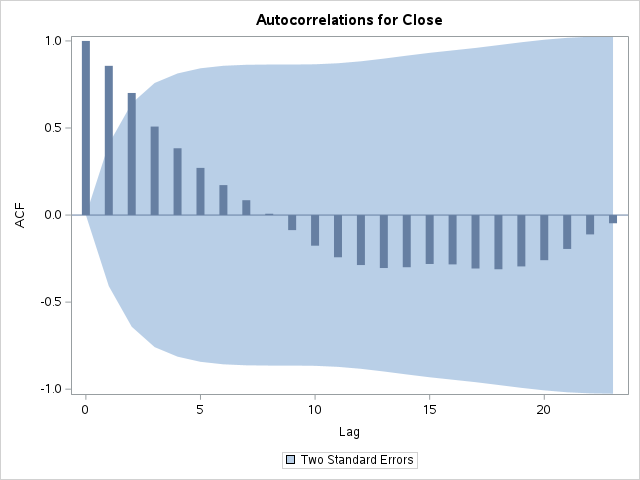
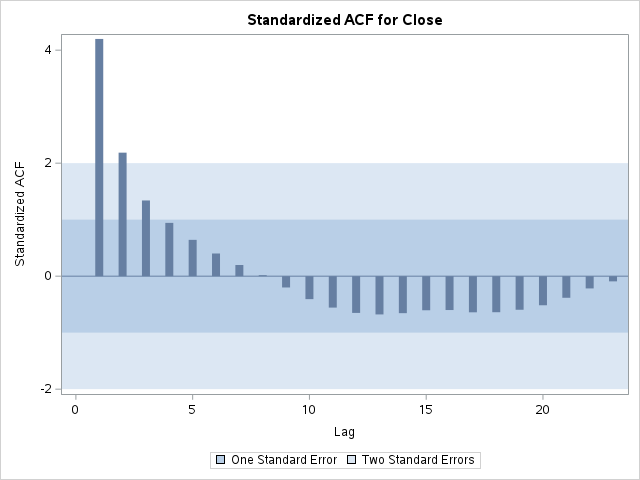
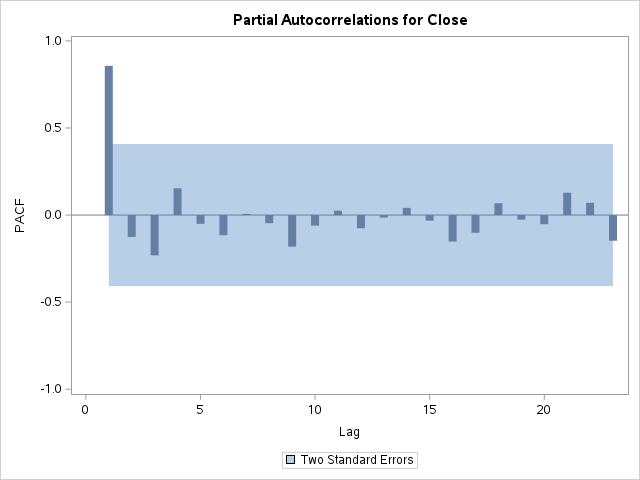
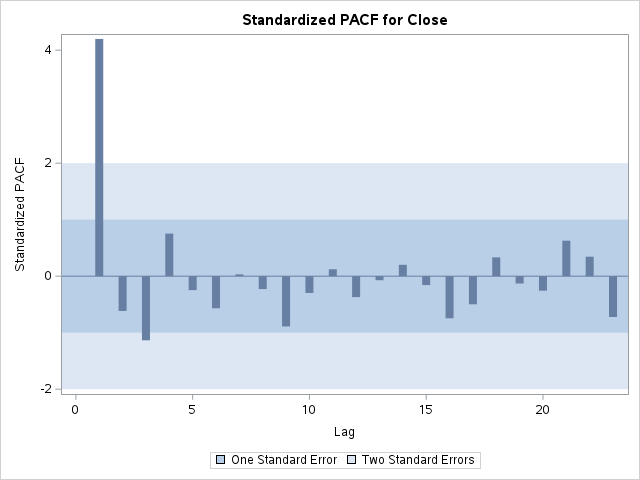

In [7]:
%%SAS sas_sess

/* accumulate to a yearly interval using AVERAGE */
proc timeseries data=SP500data out=out_totalmonth plots=(series  ACF PACF);
    id date interval=year accumulate=average;
    var close;
    title "Accumulate by year - Average";
run;
title;

#### Note: A gradual geometrically declining ACF and a PACF that is significant for only a few lags indicate an AR process. MA process shows a gradually geometrically declining PACF and the ACF has a few significant lags. An ARMA process is indicated by geometrically filling ACF and PACF.

In [ ]:
%%SAS sas_sess

proc sgplot data = SP500data;
    title 'Series plots';
    SERIES X = Date Y = Open;
    SERIES X = Date Y = Close;
    YAXIS LABEL = 'Price $';
run;
title;

proc sgplot data=SP500data;
    title 'HIGH-LOW Plot';
    highlow x=date high=high low=low / close=close;
    YAXIS LABEL = 'Price $';
run;
title;

#### series of SP500 is having an increasing trend of prices and this is a non-stationary series for sure. The index continued a strong increase trend, Clearly, there is no seasonality (no repeating patterns in the data series). The average of the series tends to change.

#### Open, close low , high shows similar pattern.

### Classical decomposition

#### Additive combination
    If the seasonal and noise components change the trend by an amount that is independent of the value of trend, the trend, seasonal and noise components are said to behave in an additive way. 


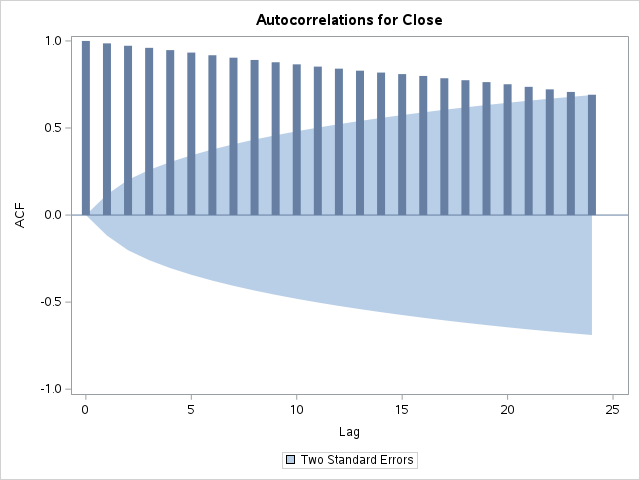
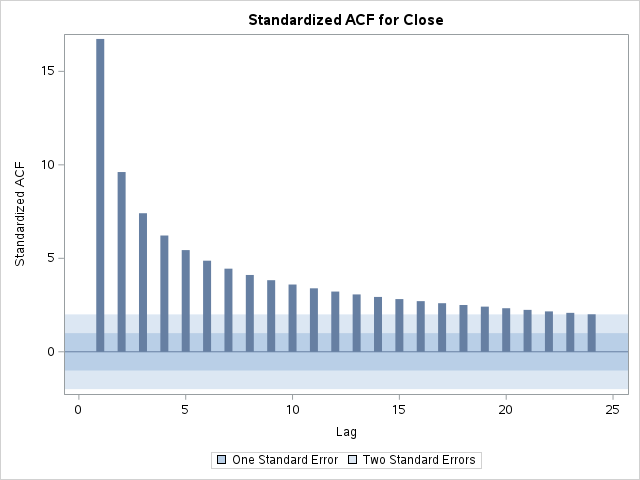
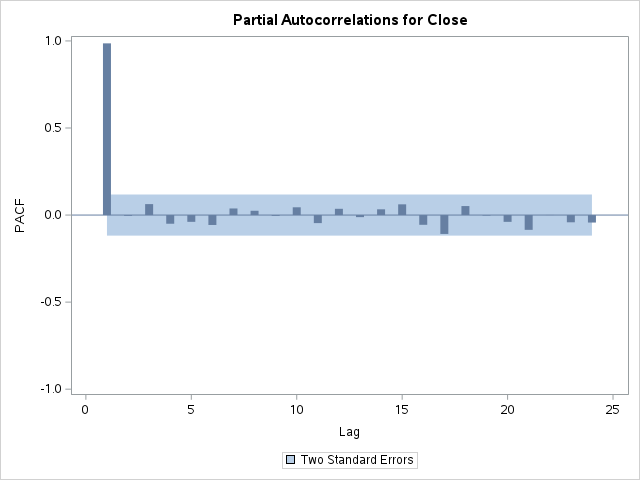
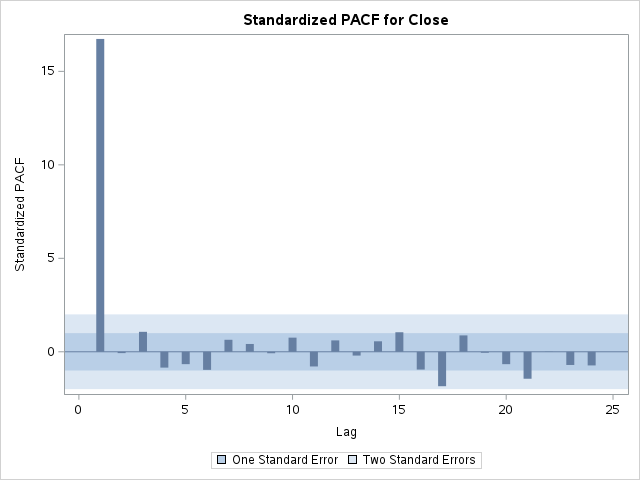
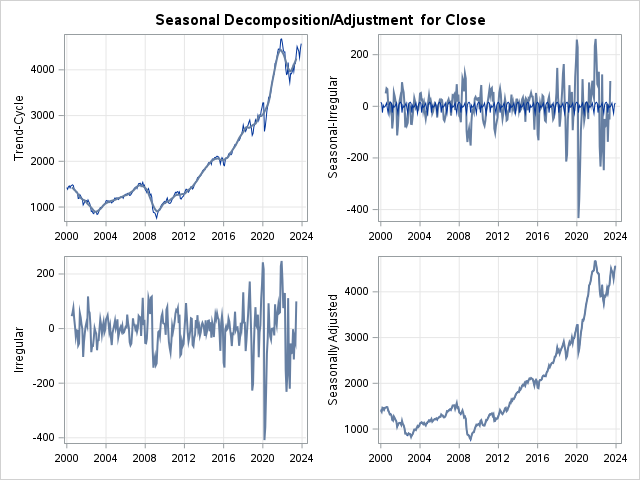
...
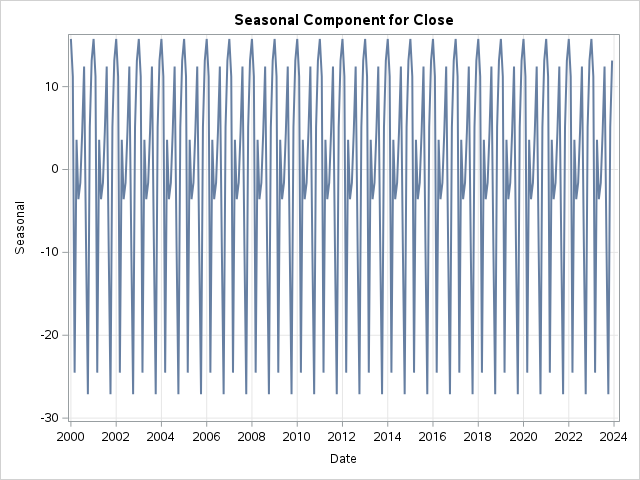
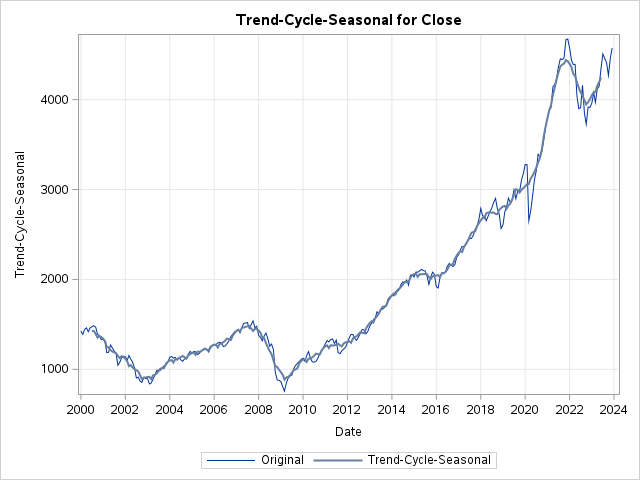
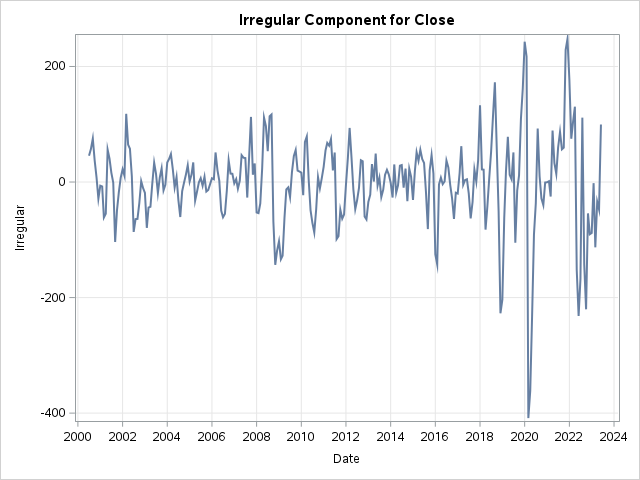
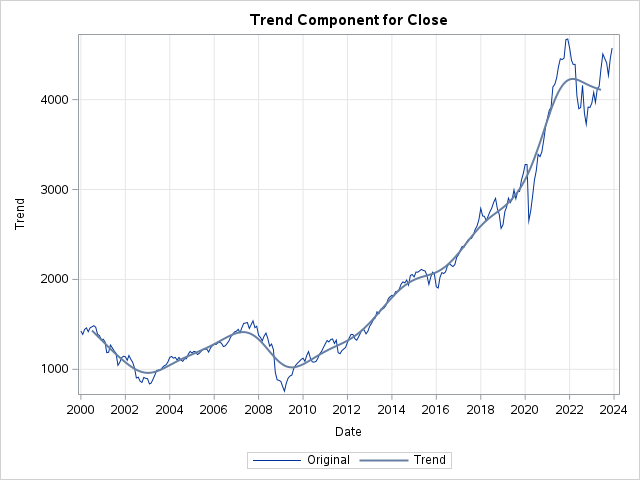
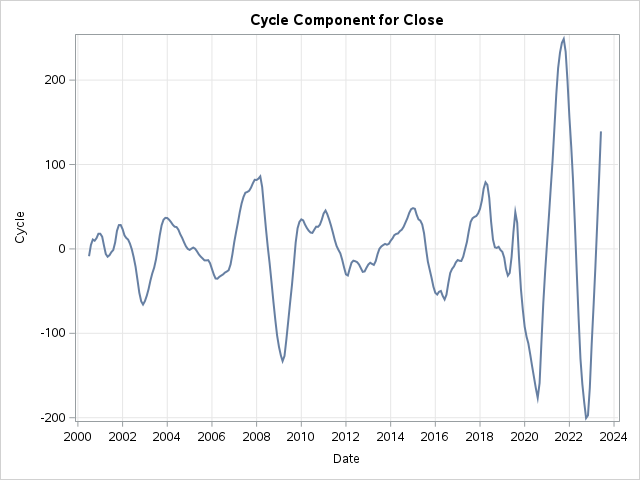

In [8]:
%%SAS sas_sess


proc timeseries data=SP500data 
    plot=(TC SC CC IC TCC TCS DECOMP ACF PACF);
    decomp orig tcc sc ic sa / mode=ADD;   /* uses additive decomposition.*/
    id date interval=month accumulate=avg; /* using monthly avg accumulated time series*/
    var close;
    title "Classical decomposition on monthly average interval";
run;
title;

#### If the seasonal and noise components change the trend by an amount that depends on the value of trend, the three components are said to behave in a multiplicative way

#### multiplicative decomposition


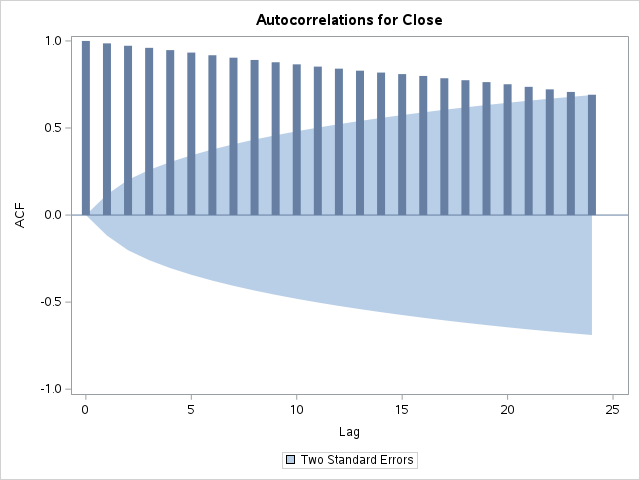
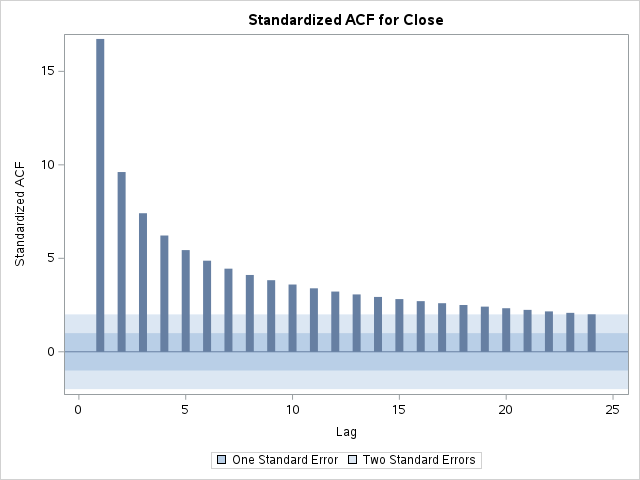
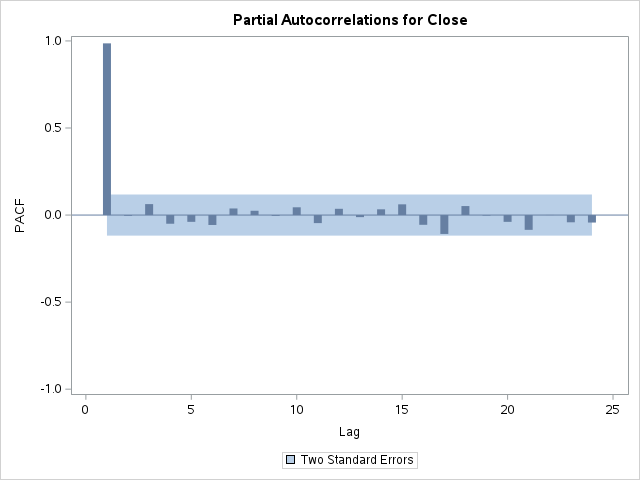
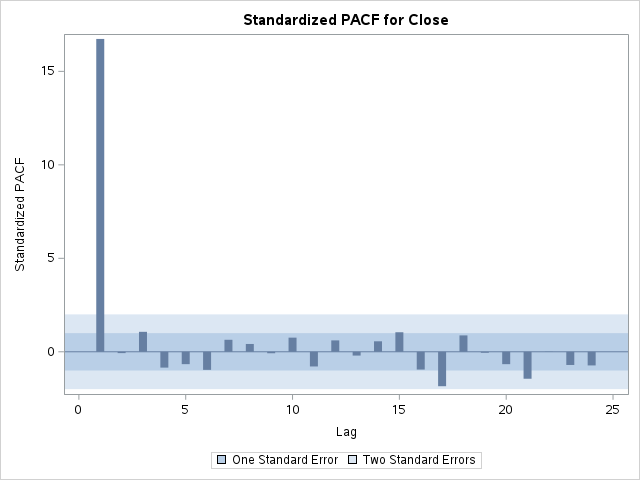
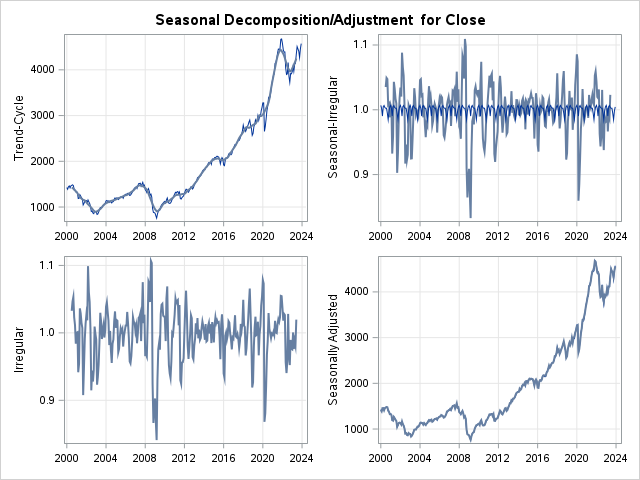
...
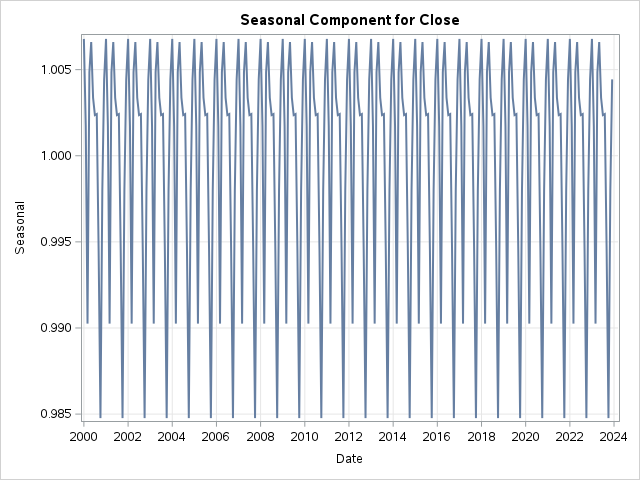
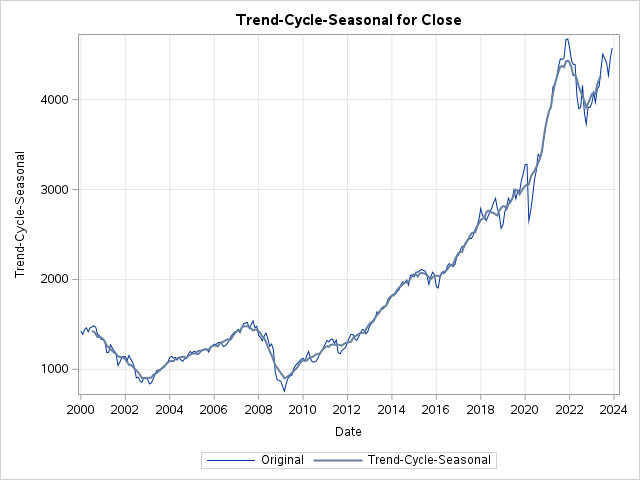
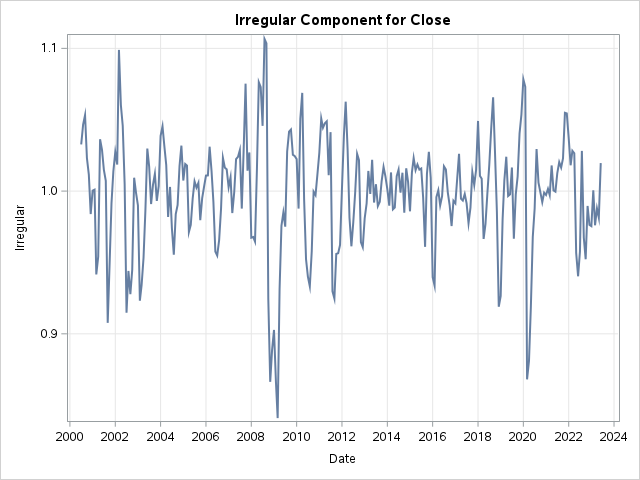
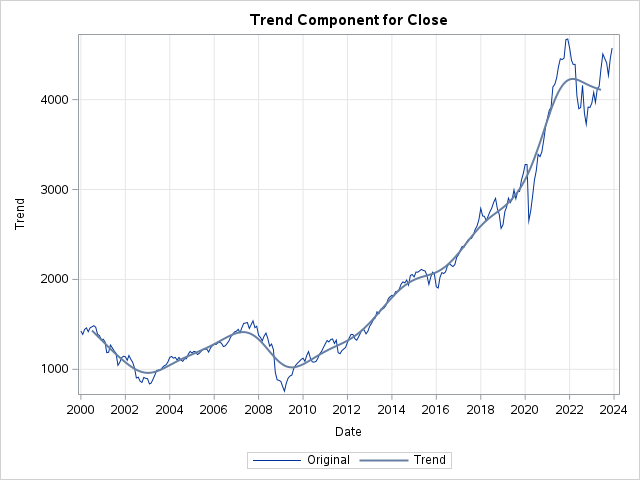
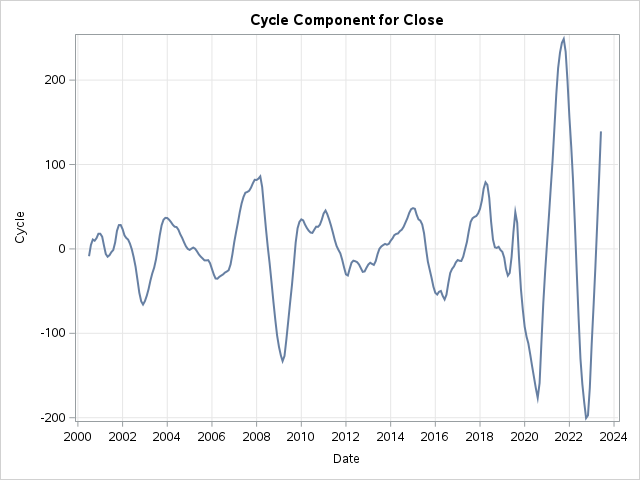

In [9]:
%%SAS sas_sess


proc timeseries data=SP500data 
    plot=(TC SC CC IC TCC TCS DECOMP ACF PACF);
    decomp orig tcc sc ic sa / mode=MULT;   /* uses multiplicative decomposition.*/
    id date interval=month accumulate=avg; /* using monthly avg accumulated time series*/
    var close;
    title "Classical decomposition on monthly average interval";
run;
title;

#### A gradual geometrically declining ACF and a PACF this is significant for only a fee lags indicate an AP process. Copying is not allowed. With 1 significant PACF lags and gradually falling ACF, we can say that the series is an AR(1) process.

### Stationarity Test


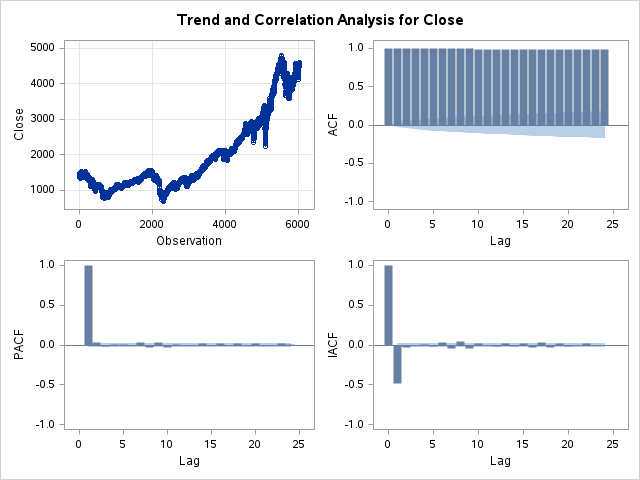
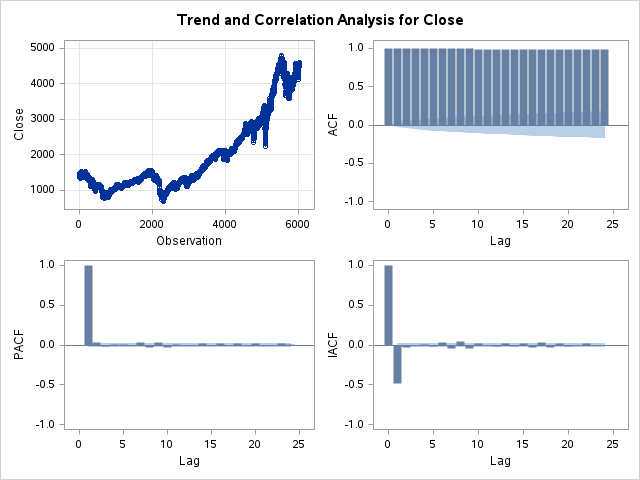

In [10]:
%%SAS sas_sess

PROC ARIMA DATA= SP500data ;
    IDENTIFY VAR = close STATIONARITY= (ADF=1) ; /* augmented Dickey-Fuller (ADF) tests.*/
RUN;
    identify var=close stationarity=(pp=1);   /* Phillips-Perron (PP) tests*/
RUN;

#### The row of 0 lags shows test statistics for an AR(1) model, where zero lagged differences are used in the test regression. The row of 1 lag shows test statistics for the AR(2) model, where one lagged differenced term is used in the test regression. 

#### Tau test statistics are mostly used to decide whether to reject the null hypothesis. The p-values of the tau test statistics in both the AR(1) and AR(2) models are greater than 0.1, and the null hypothesis (the series is nonstationary; that is, there is a unit root) cannot be rejected at the 10% level.

#### Check Tau Statistics (Pr < Tau) in ADF Unit Root Tests table. It should be less than 0.05 to say data is stationary at 5% level of significance. Therefore this is non-stationary series.

 #### PP tests p-values of the tau test statistics are greater than 0.1, and therefore the PP tests also fail to reject the null hypothesis that the series is nonstationary.

### Check Seasonality


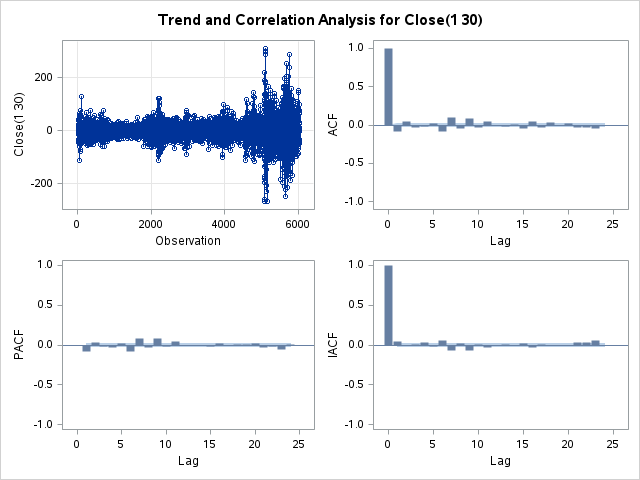

In [11]:
%%SAS sas_sess

PROC ARIMA DATA= SP500data ;
    IDENTIFY VAR = close(1,30)  /* define the 1st and 30th order of differencing. monthly seasonality. */
    STATIONARITY= (ADF=1) ; /* augmented Dickey-Fuller (ADF) tests.*/
RUN;

#### Check Tau Statistics (Pr < Tau) in ADF Unit Root Tests table again and see if the value <0.05 to say data is stationary at 5% level of significance.

###  Cubic fit


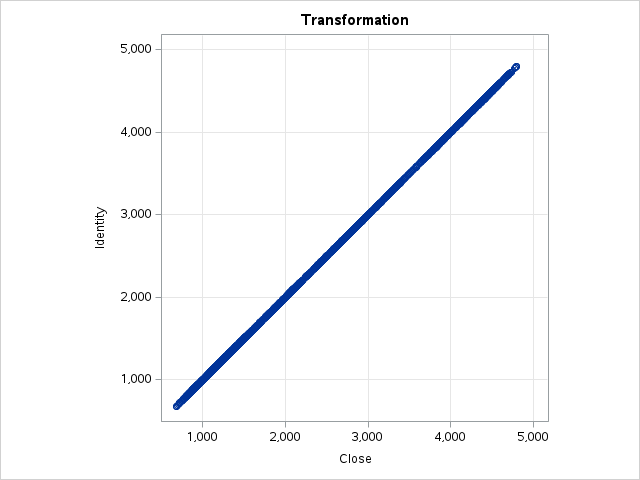
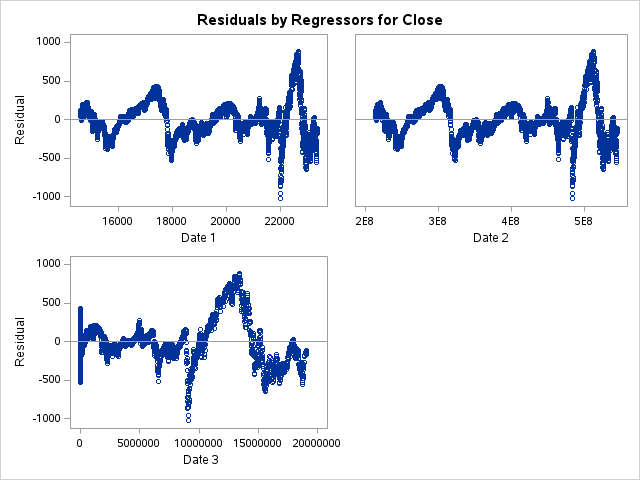
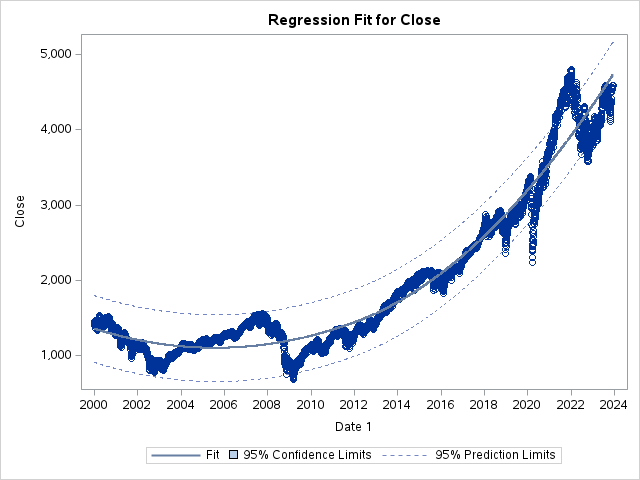
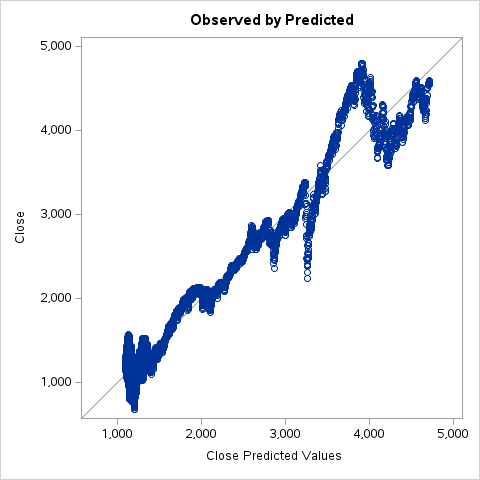

In [12]:
%%SAS sas_sess

proc transreg data=SP500data 
        PLOTS= all
        SOLVE     /* Attempts direct solution instead of iteration */
        SS2       /* Displays regression results */
        PREDICTED; /* Outputs predicted values */
        ods output fitstatistics=fs coef=c;
   model identity(Close) = pspline(Date / nknots=1 degree = 2);    /*  piecewise polynomial basis, fitting two second-degree polynomials*/
    OUTPUT OUT = fitted_model;
run;





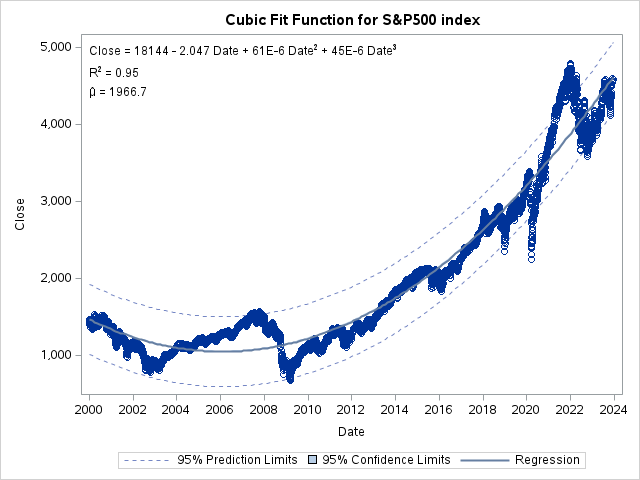

In [13]:
%%SAS sas_sess

/* code from https://support.sas.com/rnd/app/ODSGraphics/papers/odsgraph_regression.pdf p22-23 */

data _null_;
    set fs;
    if _n_ = 1 then call symputx('R2' , put(value2, 4.2) , 'G');
    if _n_ = 2 then call symputx('mean', put(value1, best6.), 'G');
run;

data _null_;
    set c end=eof;
    length s $ 200 p $ 1;
    retain s ' ';
    if _n_ = 1 then
        s = scan(dependent, 2, '()') || ' = ' || /* dependent = */
        put(coefficient, best5. -L); /* intercept */
    else if abs(coefficient) > 1e-8 then do; /* skip zero coefficients */
        p = scan(variable, -1, '_'); /* grab power */
        variable = substr(variable, index(variable, '.') + 1);
        variable = substr(variable, 1, find(variable, '_', -200) - 1);
        s = trim(s) || ' ' || /* string so far */
        scan('+ -', 1 + (coefficient < 0), ' ') /* + (add) or - (subtract) */
        || ' ' ||
        trim(put(abs(coefficient), best5. -L )) /* abs(coefficient) */
        || ' ' || variable; /* variable name */
    if p ne '1' then /* skip power for linear */
        s = trim(s) || /* string so far */
        "(*ESC*){sup '" || p || "'}"; /* add superscript */
        end;
    if eof then call symputx('formula', s, 'G');
run;

proc sgplot data=SP500data;
    title 'Cubic Fit Function for S&P500 index';
    inset "&formula"
    "R(*ESC*){sup '2'} = &r2"
    "(*ESC*){unicode mu}(*ESC*){unicode hat} = &mean" / position=topleft;
    reg y=close x=date / degree=2 cli clm;
run;
title;

### Linear fitting - using data after Jan 01, 2009


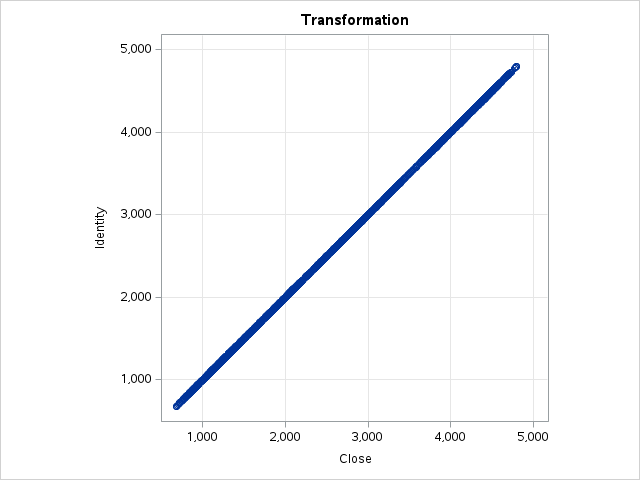
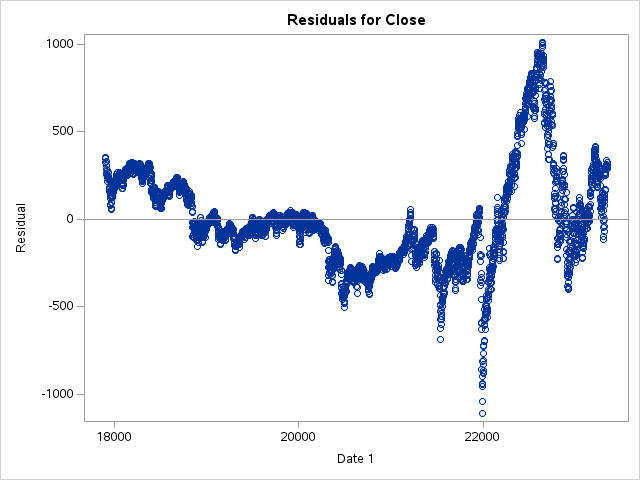
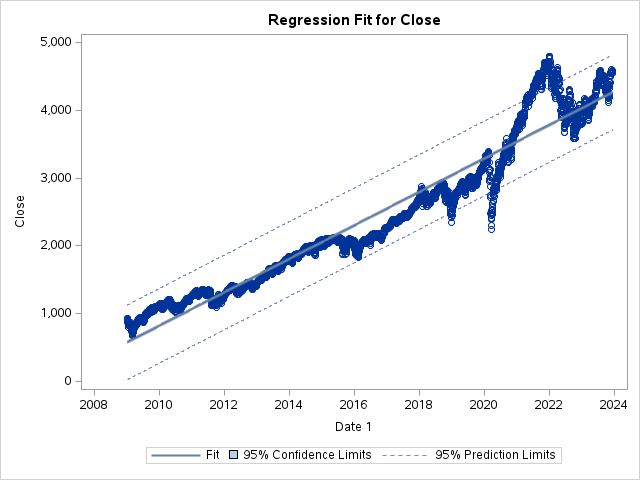
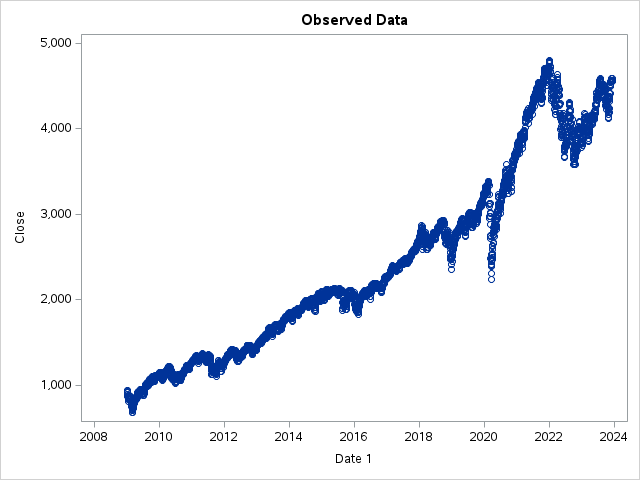
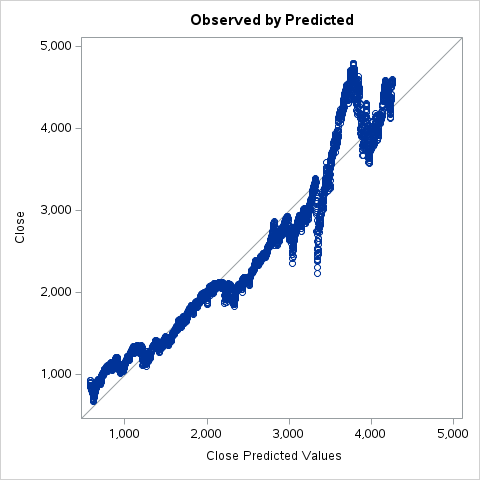

In [19]:
%%SAS sas_sess

DATA data2009 (where= (date>='01jan2009'd));
    SET SP500data;
RUN;


proc transreg data=data2009 
        PLOTS= all
        SOLVE     /* Attempts direct solution instead of iteration */
        SS2       /* Displays regression results */
        PREDICTED; /* Outputs predicted values */
        ods output fitstatistics=fs2 coef=c2;
   model identity(Close) = pspline(Date / nknots=0 degree = 1);    /*  piecewise polynomial basis, fitting two second-degree polynomials*/
    OUTPUT OUT = fitted_model2;
run;


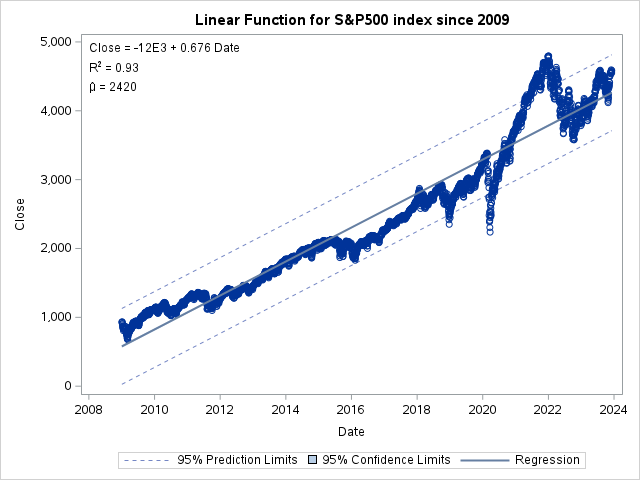

In [20]:
%%SAS sas_sess

data _null_;
    set fs2;
    if _n_ = 1 then call symputx('R2' , put(value2, 4.2) , 'G');
    if _n_ = 2 then call symputx('mean', put(value1, best6.), 'G');
run;

data _null_;
    set c2 end=eof;
    length s $ 200 p $ 1;
    retain s ' ';
    if _n_ = 1 then
        s = scan(dependent, 2, '()') || ' = ' || /* dependent = */
        put(coefficient, best5. -L); /* intercept */
    else if abs(coefficient) > 1e-8 then do; /* skip zero coefficients */
        p = scan(variable, -1, '_'); /* grab power */
        variable = substr(variable, index(variable, '.') + 1);
        variable = substr(variable, 1, find(variable, '_', -200) - 1);
        s = trim(s) || ' ' || /* string so far */
        scan('+ -', 1 + (coefficient < 0), ' ') /* + (add) or - (subtract) */
        || ' ' ||
        trim(put(abs(coefficient), best5. -L )) /* abs(coefficient) */
        || ' ' || variable; /* variable name */
    if p ne '1' then /* skip power for linear */
        s = trim(s) || /* string so far */
        "(*ESC*){sup '" || p || "'}"; /* add superscript */
        end;
    if eof then call symputx('formula', s, 'G');
run;




proc sgplot data=data2009;
    title 'Linear Function for S&P500 index since 2009';
    inset "&formula"
    "R(*ESC*){sup '2'} = &r2"
    "(*ESC*){unicode mu}(*ESC*){unicode hat} = &mean" / position=topleft;
    reg y=close x=date / degree=1 cli clm;
run;
title;

### Data Transformation - Non stationarity to stationarity


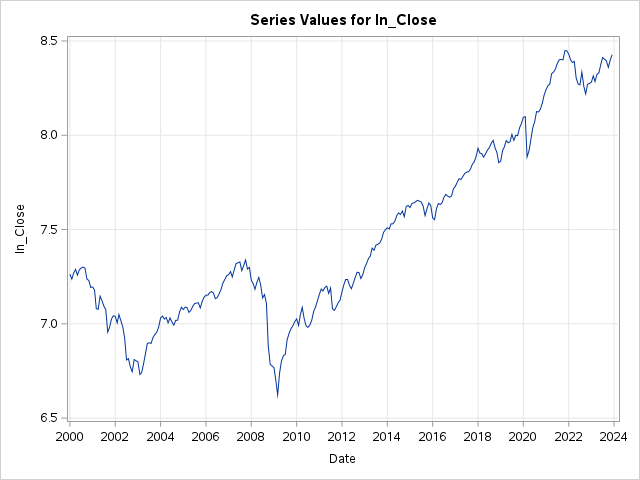
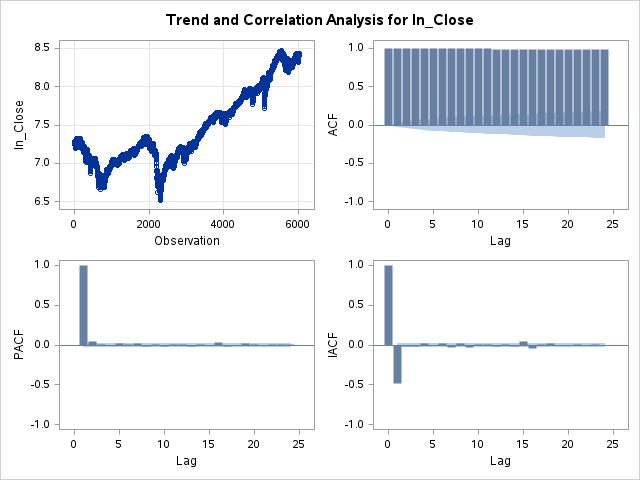
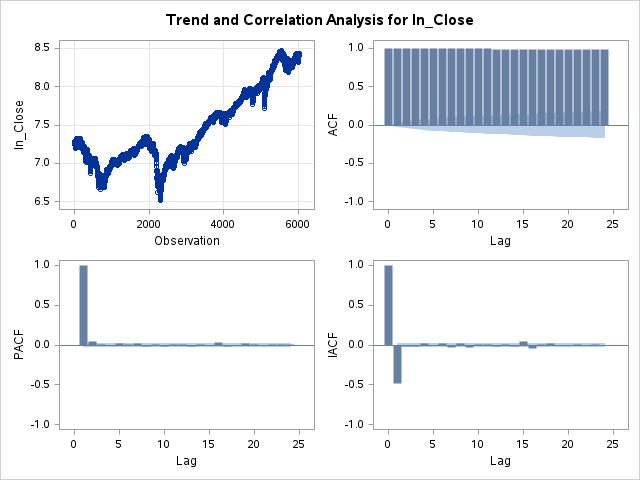
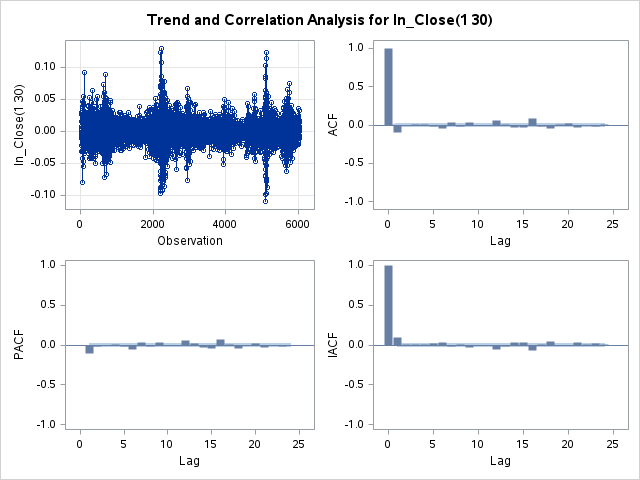
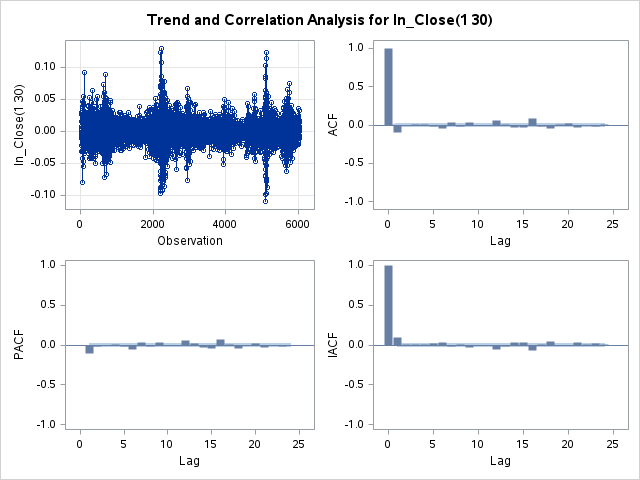

In [22]:
%%SAS sas_sess


DATA data_transformed;
    ln_Close=log(Close);  /*logarithmic transformation */
    SET SP500data;
    
RUN;

PROC TIMESERIES data=data_transformed plot=series;
 ID date interval=month accumulate=average;
 VAR ln_Close;
RUN;


PROC ARIMA DATA= data_transformed ;
    IDENTIFY VAR = ln_Close STATIONARITY= (ADF=1) ; /* augmented Dickey-Fuller (ADF) tests.*/
RUN;
    identify var=ln_Close stationarity=(pp=1);   /* Phillips-Perron (PP) tests*/
RUN;


PROC ARIMA DATA= data_transformed ;
    IDENTIFY VAR = ln_Close(1,30) STATIONARITY= (ADF=1) ; /* augmented Dickey-Fuller (ADF) tests.*/
RUN;
    identify var=ln_Close(1,30) stationarity=(pp=1);   /* Phillips-Perron (PP) tests*/
RUN;

    Null Hypothesis : Non-Stationary
    Alternative Hypothesis : Stationary

    There are three types by which you can calculate test statistics of dickey-fuller test.

    Zero Mean - No Intercept. Series is a random walk without drift.
    Single Mean - Includes Intercept. Series is a random walk with drift.
    Trend - Includes Intercept and Trend. Series is a random walk with linear trend.

#### Transformations such as logarithms can help to stabilise the variance of a time series.

#### Differencing can help stabilise the mean of a time series by removing changes in the level of a time series, and therefore eliminating (or reducing) trend and seasonality.

### Using Diagnostics to Identify ARIMA Models - Minimum Information Criteria Matrix approach


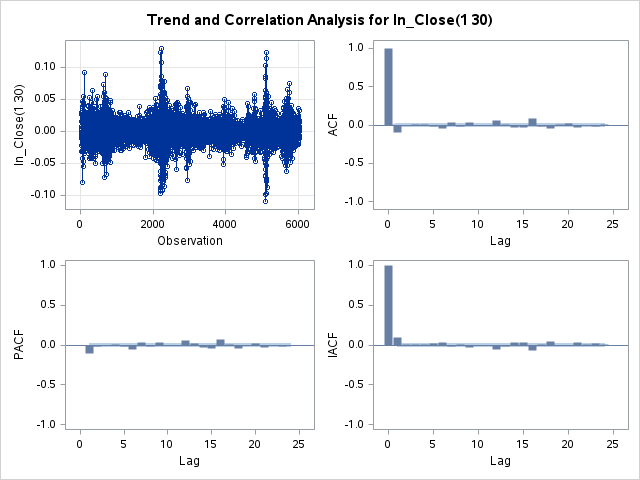

In [24]:
%%SAS sas_sess

/*-- Combination of MINIC, SCAN and ESACF Options --*/
proc arima data=data_transformed;
    identify var=ln_close(1,30) /* define the 1st and 30th order of differencing. monthly seasonality. */
        minic /* MINIC - uses information criteria or penalty functions to provide tentative ARMA order identification.*/
        esacf /* ESACF - computes the extended sample autocorrelation function */
        scan;  /* SCAN - computes estimates of the squared canonical correlations */                                           
                                            
RUN;

#### The ARIMA procedure has diagnostic options to help tentatively identify the orders of both stationary and nonstationary ARIMA processes.

#### From the SCAN Chi-Square[1] Probability Values table :  there is two (maximal) rectangular region in which all the elements are insignificant with 95% confidence. This region has a vertex at (5,4) and (4,5). From ARMA(p+d,q) Tentative Order Selection Tests gives recommendations based on the significance level specified

#### From Extended Sample Autocorrelation Function: there are two right-triangular regions in which all elements are insignificant at the 5% level. The triangle has vertices (4,5). 

#### ARIMA(p,d,q) with p = OrderOfAutoregression, d = the order of differencing (determined from PeriodsOfDifferencing), and q = OrderOfMovingAverage.

### Model Identification


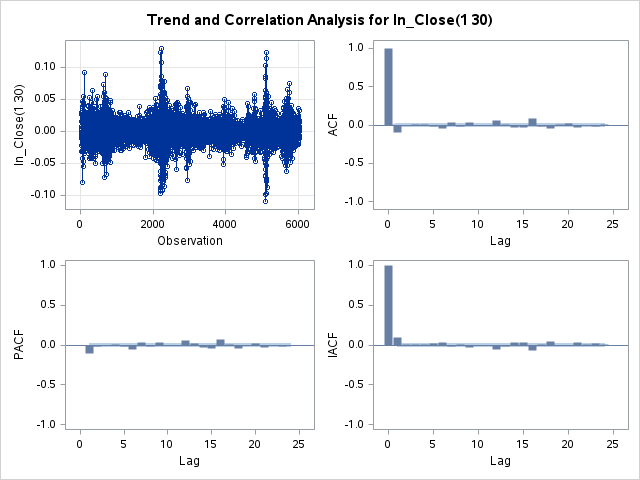
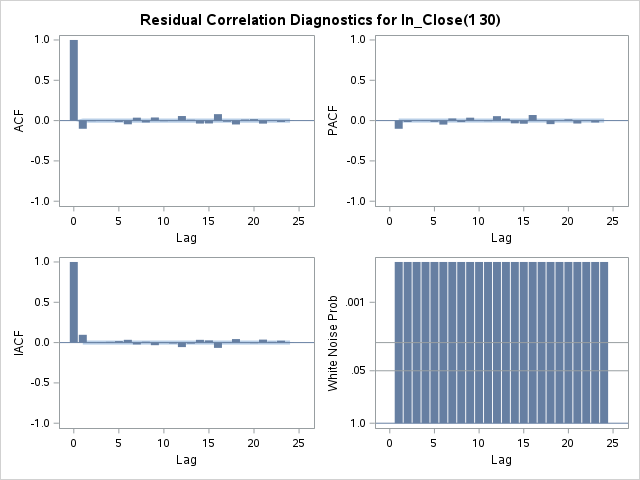
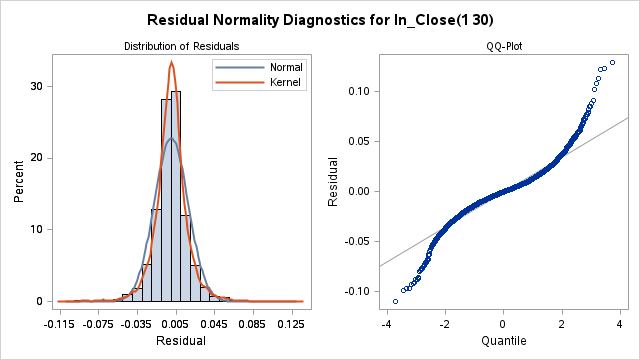
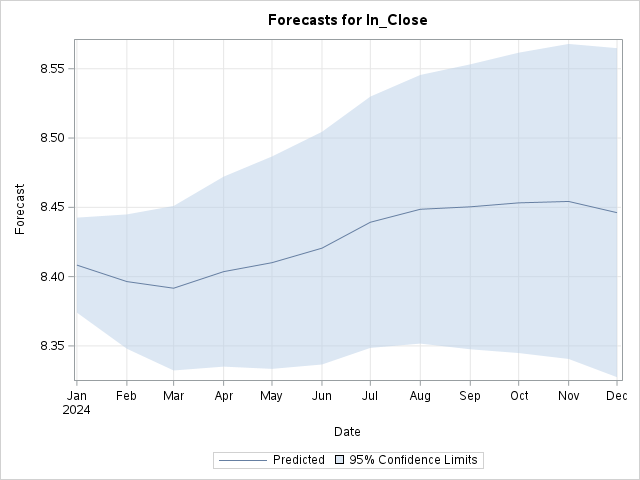
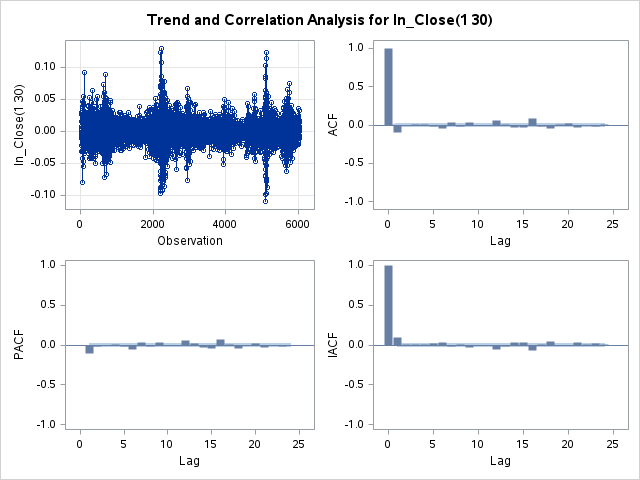
...
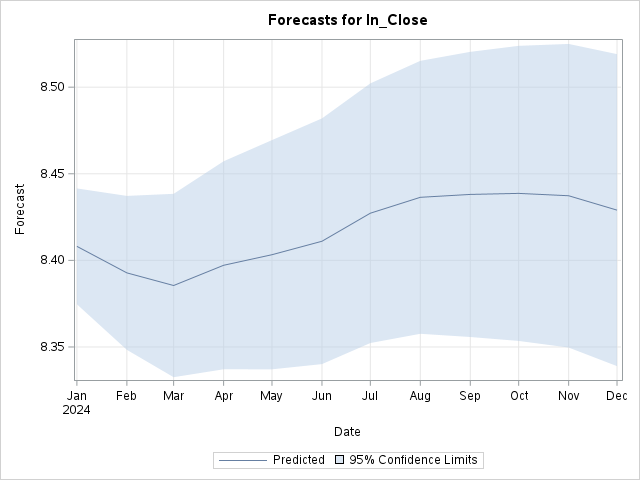
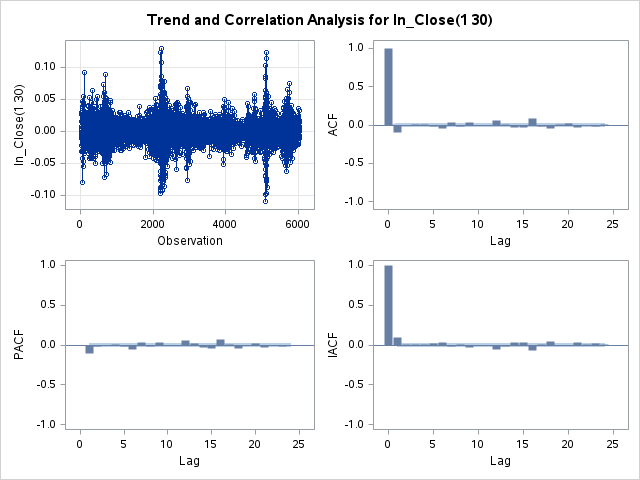
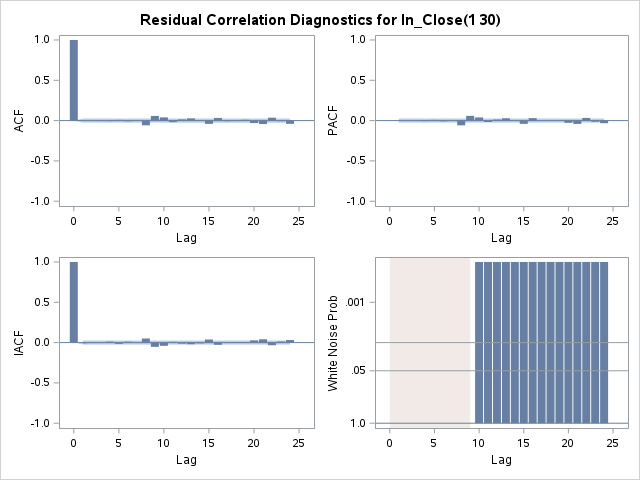
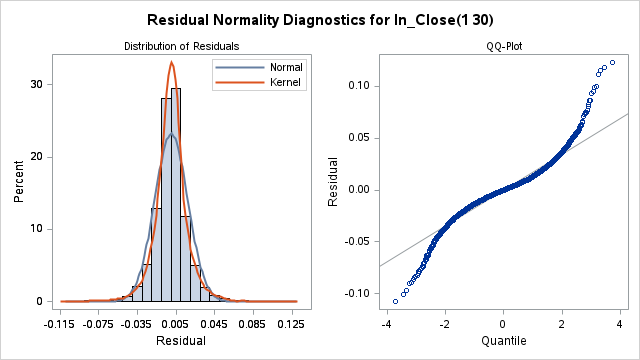
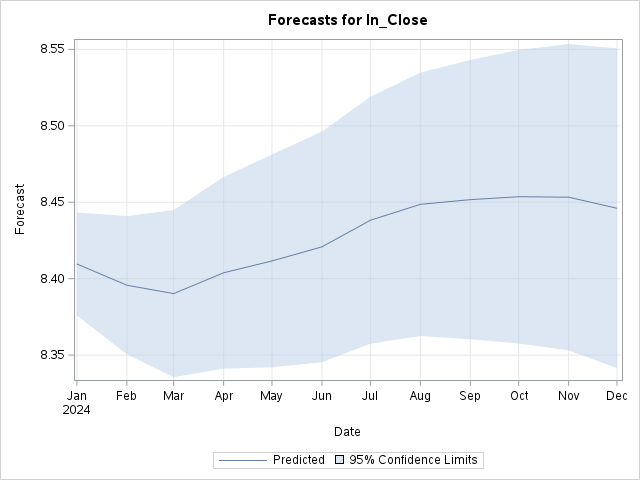

In [28]:
%%SAS sas_sess

/* code from https://www.listendata.com/2015/09/time-series-forecasting-arima-part-3.html*/
/*  Split Data into Training and Validation */

Data Training Validation;
    Set data_transformed;
    If date >= '01Jan2020'd then output Validation;
    Else output Training;
Run;

/* from aboveARMA(p+d,q) Tentative Order Selection Tests */
/*  p+d = 4 and q = 5 */
/* we iterate ARIMA model for P = 0 to 4 to Q = 0 to 5 (Except 0,0) */

%Macro top_models;
%let MINIC_p = 4;
%let MINIC_q = 5;

%do p = 0 % to &MINIC_p ;
%do q = 0 % to &MINIC_q ;

    PROC ARIMA DATA= data_transformed ;
        IDENTIFY VAR = ln_Close(1,30)  ;
        ESTIMATE P = &p. Q =&q.  OUTSTAT= stats_&p._&q. ;
        Forecast lead=12 interval = month id = date    /* forcast 12 months */
        out = result_&p._&q.;
    RUN;


    data stats_&p._&q.;
        set   stats_&p._&q.;
        p = &p.;
        q = &q.;
    Run;

    data result_&p._&q.;
        set   result_&p._&q.;
        p = &p.;
        q = &q.;
    Run;

%end;
%end;

    Data final_stats ;
        set %do p = 0 % to &MINIC_p ;
        %do q = 0 % to &MINIC_q ;
        stats_&p._&q. 
        %end;
        %end;;
    Run;
    Data final_results ;
        set %do p = 0 % to &MINIC_p ;
        %do q = 0 % to &MINIC_q ;
        result_&p._&q.
        %end;
        %end;;
    Run;

%Mend;
%top_models

/* Then to calculate the mean of AIC and SBC*/
proc sql;
    create table final_stats_1  as select p,q, sum(_VALUE_)/2 as mean_aic_sbc from final_stats
    where _STAT_ in ('AIC','SBC')
    group by p,q
    order by mean_aic_sbc;
quit;

#### Mean Squared Percentage Error (MAPE) for each model :

In [29]:
%%SAS sas_sess

Proc SQL;
    create table final_results_1 as select a.p, a.q, a.date, a.forecast, b.ln_Close
    from final_results as a join validation as b
    on a.date = b.date;
quit;

Data Mape;
    set final_results_1 ;
    Ind_Mape = abs(ln_Close - forecast)/ ln_Close;
Run;


Proc Sql;
    create table mape as select p, q, mean(ind_mape) as mape from mape
    group by p, q
    order by mape ;
quit;

proc print data=mape;
RUN;

Obs,p,q,mape
1,3,4,.001673002
2,3,2,.001704964
3,1,3,.001708714
4,2,3,.001709917
5,2,2,.001710517
6,1,5,.001716907
7,4,4,.001718521
8,4,3,.001721513
9,3,5,.001726390
10,1,0,.001734368


### Model with least MAPE is finally your model which is p= 3, q=4;

    Reference:
        - https://www.listendata.com/2015/09/time-series-forecasting-arima-part-2.html
        - https://medium.com/@msdhina87/s-p-500-stock-price-forecast-using-sas-e05824ad665d
        - https://pub.towardsai.net/time-series-analysis-in-sas-8b6c03b39fd4
        - https://www.sfu.ca/sasdoc/sashtml/ets/chap7/sect56.htm
        - https://documentation.sas.com/doc/en/pgmsascdc/9.4_3.4/etsug/etsug_arima_examples05.htm
        - https://stats.oarc.ucla.edu/sas/faq/how-do-i-create-time-series-variables-using-proc-expand/
        - https://spureconomics.com/interpreting-acf-and-pacf-plots/
        - https://spureconomics.com/arima-model-estimation-and-model-selection/
        - https://blogs.oracle.com/ai-and-datascience/post/performing-a-time-series-analysis-on-the-sampp-500-stock-index